<a href="https://colab.research.google.com/github/alvaroame/CBIR/blob/main/IREI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!pip install tensorflow

In [7]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.models import Model
from PIL import Image
from pathlib import Path
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import math 

def printImage(pathImg):
    m = Image.open(Path(pathImg))
    fig = plt.figure(figsize=(7,7))
    plt.imshow(m)
    plt.axis('off')
    plt.show()

def printImages(scores, max_imgs = 10):
  fig = plt.figure(figsize=(30, 6))
  columns = 10
  rows = math.ceil(max_imgs/columns)
  total = len(scores)
  for i in range(1, columns*rows +1):
      if i > total or i > max_imgs:
        break 
      score, pathImg = scores[i-1]
      img = Image.open(Path(pathImg))
      ax = fig.add_subplot(rows, columns, i)
      ax.set_title(score)
      plt.axis('off')
      plt.imshow(img)
  plt.show()

def loadFeatures(pathImgs, pathFeatures):
    features = []
    img_paths = []
    for feature_path in Path(pathFeatures).glob("*.npy"):
        features.append(np.load(feature_path))
        img_paths.append(Path(pathImgs) / (feature_path.stem + ".jpg"))
    features = np.array(features)
    return features, img_paths

**CNN**

For extracting features, there are lots of options to choose. In this case, we can use a convolutional neural network (CNN) for extracting those features. This model has a greater capability to capture patterns than any other algorithms thanks to its convolutional layer that captures the neighbor for each instance of the data. Convolutional Neural Network consists of layers, such as convolutional layer for feature extraction, pooling layer for sampling the features, and fully-connected layer for doing prediction. For this case, we ignore most of the fully-connected layers and focus only on the feature extraction result only.

After we extract features, we calculate the distance between the query and all images. For doing this, we can use the Euclidean distance or l2 norm to measure it. If the number is getting smaller, the pair of images are similar to each other.

In [8]:
base_model = VGG16(weights='imagenet')
model = Model(inputs=base_model.input, outputs=base_model.get_layer('fc1').output)
def getFeaturesVGG(img):
    """
    Extract a deep feature from an input image
    Args:
        img: from PIL.Image.open(path) or tensorflow.keras.preprocessing.image.load_img(path)
    Returns:
        feature (np.ndarray): deep feature with the shape=(4096, )
    """
    img = img.resize((224, 224))  # VGG must take a 224x224 img as an input
    img = img.convert('RGB')  # Make sure img is color
    x = image.img_to_array(img)  # To np.array. Height x Width x Channel. dtype=float32
    x = np.expand_dims(x, axis=0)  # (H, W, C)->(1, H, W, C), where the first elem is the number of img
    x = preprocess_input(x)  # Subtracting avg values for each pixel
    feature = model.predict(x)[0]  # (1, 4096) -> (4096, )
    return feature / np.linalg.norm(feature)  # Normalize

def saveFeaturesVGG(pathImgs, pathFeatures):
    for img_path in sorted(Path(pathImgs).glob("*.jpg")):
      print(img_path)  #/xxx.jpg
      feature = getFeaturesVGG(img=Image.open(img_path))
      feature_path = Path(pathFeatures) / (img_path.stem + ".npy")  #/feature/xxx.npy
      print(feature_path)
      np.save(feature_path, feature)

def getScoresVGG(pathImg, max_results = 10):
    img = Image.open(Path(pathImg))
    query = getFeaturesVGG(img)
    dists = np.linalg.norm(featuresVGG-query, axis=1)  # L2 distances to features
    ids = np.argsort(dists)[:max_results]  # Top results
    scores = [(dists[id], img_pathsVGG[id]) for id in ids]
    return scores

def queryVGG(pathImgTest, results = 10):
    printImage(pathImgTest)
    scores = getScoresVGG(pathImgTest, results)
    printImages(scores)

**ORB**

As a second approach to extract features from images, we have decided to use ORB (oriented-FAST and Rotated BRIEF), mainly because it is an efficient alternative to SIFT and SURF algorithms and also because the previous ones are patented. ORB is basically a fusion of FAST keypoint detector and BRIEF descriptor with many modifications to enhance the performance. First, it uses FAST to find keypoints, which are small regions in an image that are very distinctives, then uses the Harris corner measure to find the top N points. Since FATS does not compute the orientation, to face rotation invariance ORB computes the intensity weighted centroid of the patch with located corner at center. After finding keypoints, ORB used BRIEF to compute feature descriptors according to the orientation of keypoints, features descriptors encode relevant information into numbers and works as a fingerprint to the image. Ideally, that information would be invariant under image transformation, so we can find the feature again even if the image is transformed in some way. In our case, we used ORB to extract 1,000 keypoints and their descriptors for each image. In total, we extract 1,000 features for each image.

The distance recommended by literature when using the ORB algorithm is NORM_HAMMING. This distance computes the Hamming distance between descriptors. We used this distance to find the best matches among descriptors. Then, we used those good matches to compute a score for an image in order to find images that are more similar to the query image. The more good matches the best score and the best score the more similar the image to the query image. Since the best score is obtained when all the number of features are good features, we can get the difference between the number of features extracted and the number of good matches to get smaller values for more similar images. 

In [9]:
# Initiate ORB detector
NFEATURES = 1000
orb = cv.ORB_create(nfeatures = NFEATURES)
def getFeaturesORB(orb, pathImg):
    img = cv.imread(pathImg, cv.IMREAD_GRAYSCALE)
    # find the keypoints and descriptors with ORB
    kp, des = orb.detectAndCompute(img,None)
    return kp, des

def saveFeaturesORB(orb, pathImgs, pathFeatures):
   for img_path in sorted(Path(pathImgs).glob("*.jpg")):
      print(img_path)  #/xxx.jpg
      kp, feature = getFeaturesORB(orb, str(img_path))
      feature_path = Path(pathFeatures) / (img_path.stem + ".npy")  #/feature/xxx.npy
      print(feature_path)
      np.save(feature_path, feature) 

def drawKeypoints(orb, pathImg):
    # draw only keypoints location,not size and orientation
    img = cv.imread(pathImg)
    img = cv.cvtColor(img, cv.COLOR_RGB2BGR)
    kp, des = getFeaturesORB(orb, pathImg)
    imgKp = cv.drawKeypoints(img, kp, None, color=(0,255,0), flags=0)
    fig = plt.figure(figsize=(7, 10))
    plt.axis('off')
    plt.imshow(imgKp), plt.show()

def drawMatches(path, path1):
    img1 = cv.imread(path,cv.IMREAD_GRAYSCALE)
    img2 = cv.imread(path1,cv.IMREAD_GRAYSCALE)
    kp1, des1 = getFeaturesORB(orb, path)
    kp2, des2 = getFeaturesORB(orb, path1)
    matches = getMatches(des1, des2)
    # Draw first 10 matches.
    img3 = cv.drawMatches(img1,kp1,img2,kp2,matches[:20],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    fig = plt.figure(figsize=(10, 15))
    plt.axis('off')
    plt.imshow(img3),plt.show()

def getMatches(des, des1):
    # create BFMatcher object
    bf = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)
    # Match descriptors.
    matches = bf.match(des,des1)
    # Sort them in the order of their distance.
    matches = sorted(matches, key = lambda x:x.distance)
    return matches

def getGoodMatches(des, des1, k=2):
    # create BFMatcher object
    bf = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=False)
    # Match descriptors.
    matches = bf.knnMatch(des,des1, k=k)
    # Apply ratio test
    good = []
    for m,n in matches:
      if m.distance < 0.75*n.distance:
          good.append(m)
    # Sort them in the order of their distance.
    good = sorted(good, key = lambda x:x.distance)
    return good

def getScoreORB(matches):
    nMatches = len(matches)
    distance = sum(match.distance for match in matches)
    distance = NFEATURES if distance == 0 else distance
    score = (NFEATURES - nMatches) +  (1/distance)
    return score

def getScoresORB(orb, path, max_results = 10):
    kp, queryDesc = getFeaturesORB(orb, path)
    scores = []
    for feature in featuresORB:
      #matches = getMatches(queryDesc, feature)
      matches = getGoodMatches(queryDesc, feature)
      score = getScoreORB(matches)
      scores.append(score)
    ids = np.argsort(scores)[:max_results]  # Top results
    result = [(scores[id], img_pathsORB[id]) for id in ids]
    return result

def queryORB(pathImgTest, results = 10):
    printImage(pathImgTest)
    scores = getScoresORB(orb, pathImgTest, results)
    printImages(scores)


**Saving Features**

This process has to be done just one time. 

In [10]:
pathImgs = "/content/drive/MyDrive/IREI/dataset"
pathFeaturesVGG = "/content/drive/MyDrive/IREI/dataset/features"
pathFeaturesORB = "/content/drive/MyDrive/IREI/dataset/featuresORB"
pathTest = "/content/drive/MyDrive/IREI/dataset/test"

In [ ]:
#saveFeaturesORB(orb, pathImgs, pathFeaturesORB)
#saveFeaturesVGG(pathImgs, pathFeaturesVGG)

**Load all features**

We have to load the features before starting querying the CBIR

In [12]:
featuresVGG, img_pathsVGG = loadFeatures(pathImgs, pathFeaturesVGG)
featuresORB, img_pathsORB = loadFeatures(pathImgs, pathFeaturesORB)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:40: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


**CNN EXAMPLE**

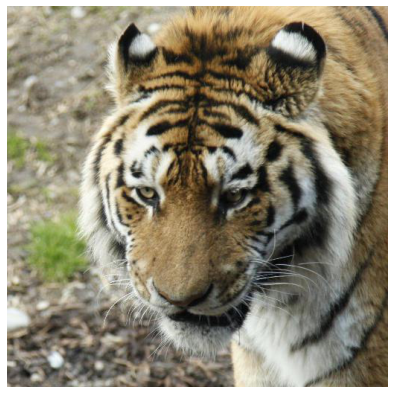

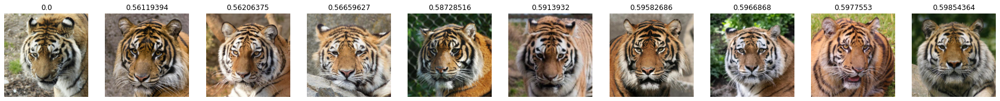

In [13]:
example = "/content/drive/MyDrive/IREI/dataset/0.jpg"
queryVGG(example)

**ORB EXAMPLE**

In [17]:
example = "/content/drive/MyDrive/IREI/dataset/0.jpg"
example1 = "/content/drive/MyDrive/IREI/dataset/22.jpg"

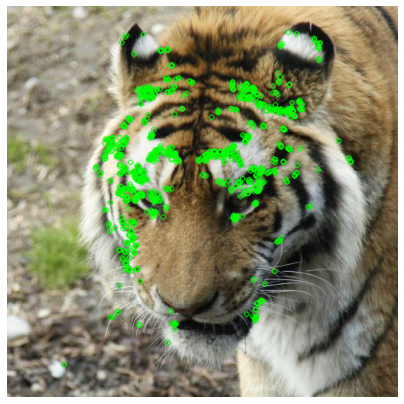

In [18]:
drawKeypoints(orb, example)

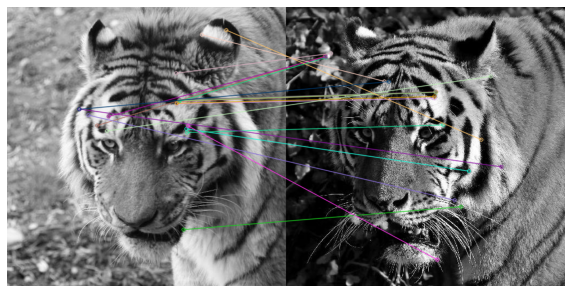

In [20]:
drawMatches(example, example1)

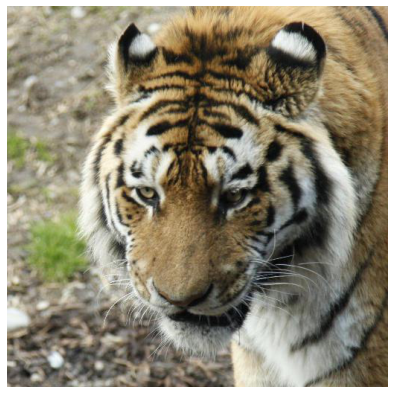

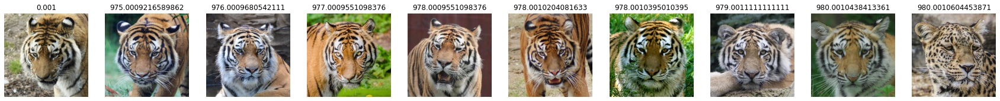

In [21]:
queryORB(example)

**CBIR**

So far, we have implemented two CBIRs, one using CNN feature extraction and another using ORB to extract features. In order to implement a robust CBIR system, we decided to combine both extractors. As the measures or scores obtained from both extractors are in different ranges of values, the better approach we found to combine them is to assign the position or rank obtained in both extractors, then we compute the mean of their position to get a new score. The lower the mean or score the more similar both images are. The proposed system mainly consists of five phases; 


*   Image acquisition
*   Feature extraction using CNN and ORB and saving to files.
*   Insert the query image and extract its features CNN and ORB.
*   Combine the scores of CNN with ORB with all images.
*   Retrieve the most similar results.




In [22]:
def query1(pathTest):
  scoresORB = getScoresORB(orb,pathTest, 100)
  scoresVGG = getScoresVGG(pathTest, 100)
  scores = {}
  for scoreVGG, pathImg in scoresVGG:
    scores[pathImg] = scoreVGG * 1500
  for scoreORB, pathImg in scoresORB:
    if pathImg in scores:
      scoreVGG = scores.get(pathImg)
      scores[pathImg] = (scoreVGG/1500) * scoreORB
  ranked = [(v, k) for k,v in scores.items()]
  top = sorted(ranked, key = lambda tup:tup[0])
  printImage(pathTest)
  printImages(scoresVGG)
  printImages(scoresORB)
  printImages(top)

def query2(pathTest):
  scoresORB = getScoresORB(orb,pathTest, 100)
  scoresVGG = getScoresVGG(pathTest, 100)
  scores = {}
    
  for scoreORB, pathImg in scoresORB:
    scores[pathImg] = scoreORB/1000

  for scoreVGG, pathImg in scoresVGG:
    scoreORB = scores.get(pathImg, 1)
    scores[pathImg] = scoreVGG * scoreORB
 
  ranked = [(v, k) for k,v in scores.items()]
  top = sorted(ranked, key = lambda tup:tup[0])
  printImage(pathTest)
  printImages(scoresVGG)
  printImages(scoresORB)
  printImages(top)

def combineScores(scoresORB, scoresVGG):
  scores = {}
  maxScoreORB = len(scoresORB) + 1
  maxScoreVGG = len(scoresVGG) + 1
  score = 0  
  for scoreORB, pathImg in scoresORB:
    score += 1
    scores[pathImg] = (score + maxScoreORB)/2
  score = 0
  for scoreVGG, pathImg in scoresVGG:
    score += 1
    if pathImg in scores:
      scoreORB = (2 * scores.get(pathImg)) - maxScoreORB
    else:
      scoreORB = maxScoreVGG
    scores[pathImg] = (score + scoreORB)/2
  ranked = [(v, k) for k,v in scores.items()]
  return sorted(ranked, key = lambda tup:tup[0])

def query(pathTest):
  scoresORB = getScoresORB(orb, pathTest, 500)
  scoresVGG = getScoresVGG(pathTest, 500)
  scores = combineScores(scoresORB, scoresVGG)
  printImage(pathTest)
  print('CNN CBIR')
  printImages(scoresVGG, 10)
  print('ORB CBIR')
  printImages(scoresORB, 10)
  print('Combined CBIR')
  printImages(scores, 10)

In [23]:
example = "/content/drive/MyDrive/IREI/dataset/0.jpg"
example1 = "/content/drive/MyDrive/IREI/dataset/1647.jpg"
example2 = "/content/drive/MyDrive/IREI/dataset/1648.jpg"
example3 = "/content/drive/MyDrive/IREI/dataset/240.jpg"
example4 = "/content/drive/MyDrive/IREI/dataset/232.jpg"

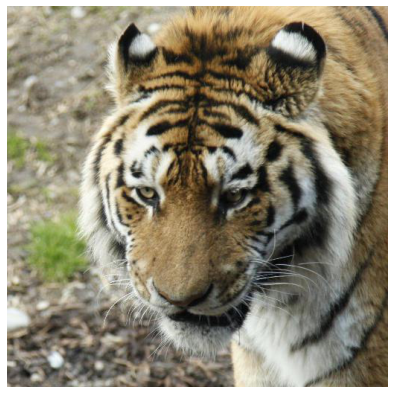

CNN CBIR


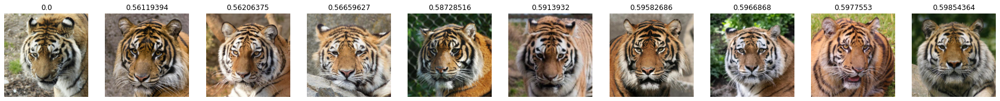

ORB CBIR


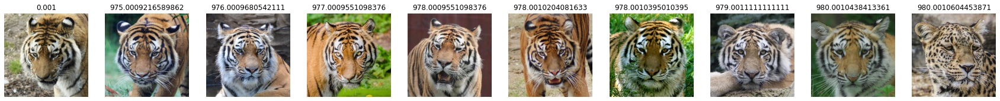

Combined CBIR


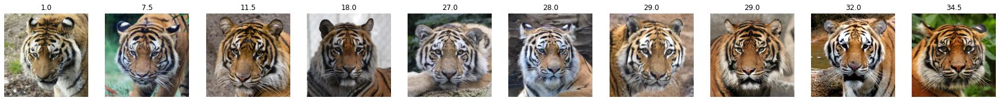

In [24]:
query(example)

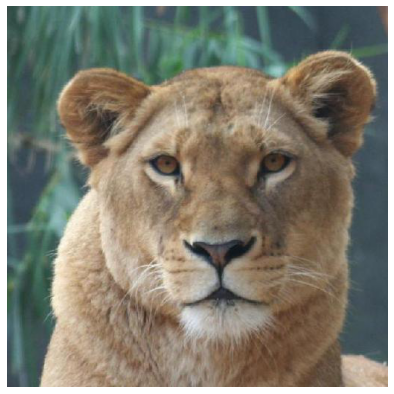

CNN CBIR


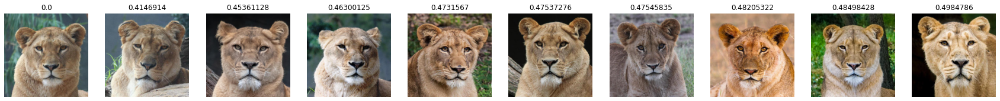

ORB CBIR


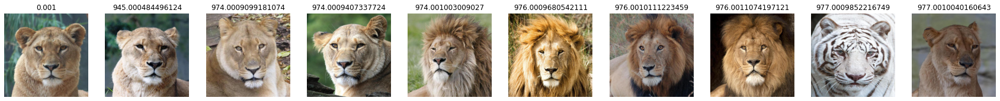

Combined CBIR


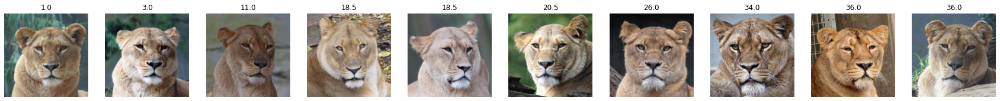

In [25]:
query(example1)

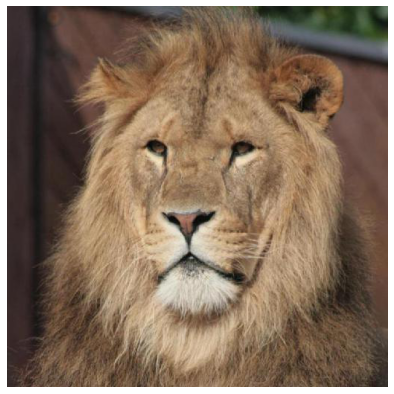

CNN CBIR


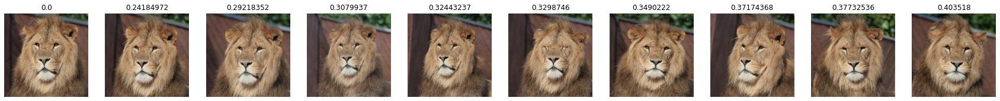

ORB CBIR


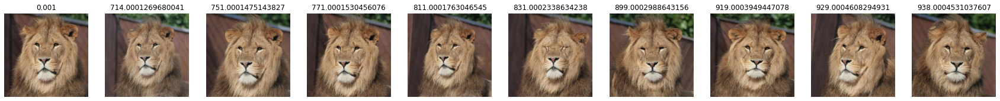

Combined CBIR


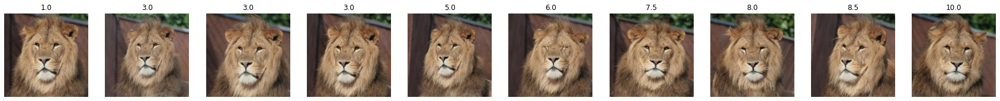

In [26]:
query(example2)

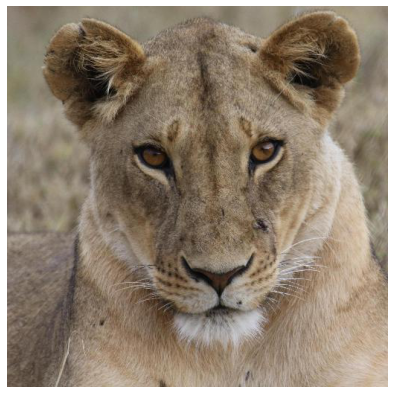

CNN CBIR


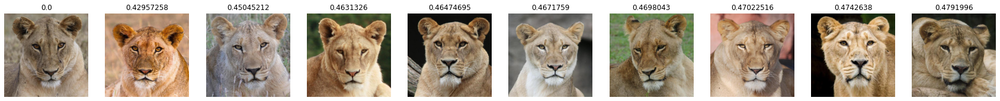

ORB CBIR


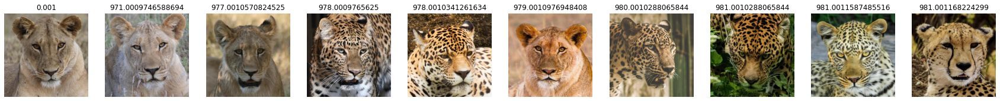

Combined CBIR


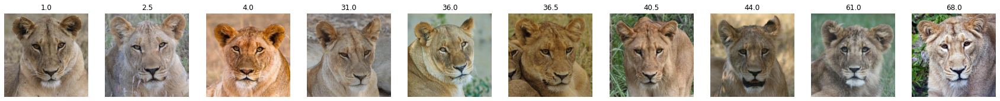

In [27]:
query(example3)

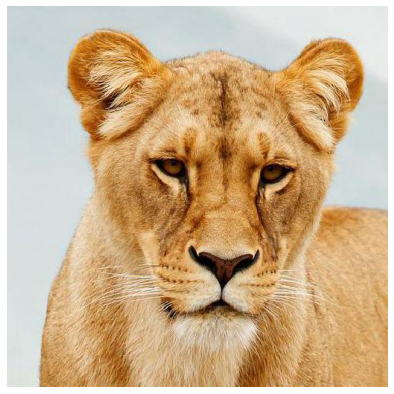

CNN CBIR


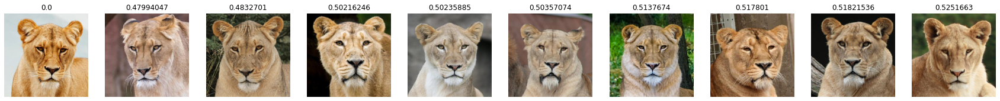

ORB CBIR


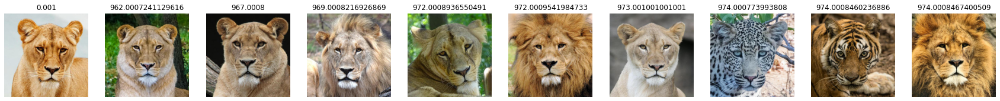

Combined CBIR


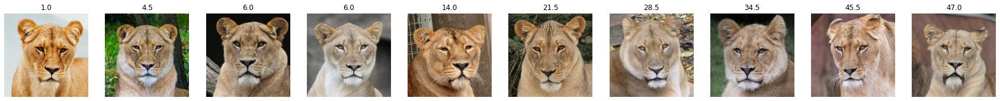

In [28]:
query(example4)

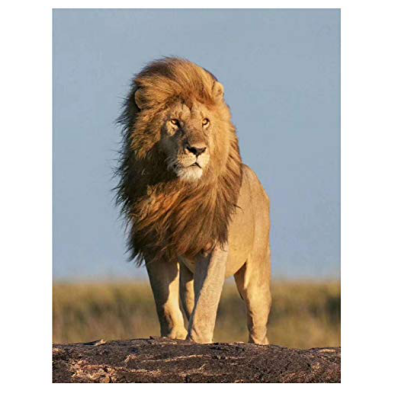

CNN CBIR


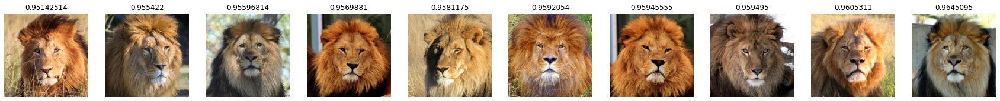

ORB CBIR


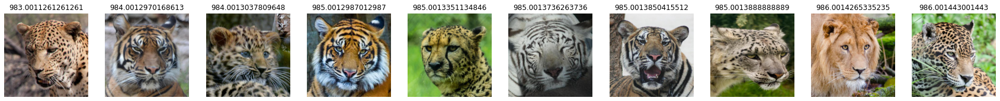

Combined CBIR


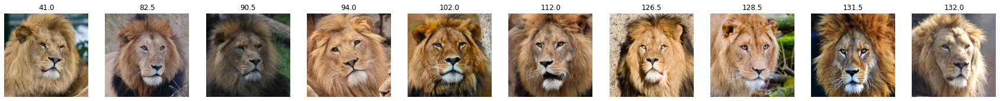

In [29]:
query("/content/drive/MyDrive/IREI/dataset/test/leon.jpg")

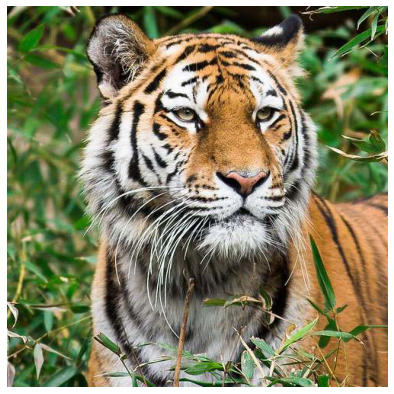

CNN CBIR


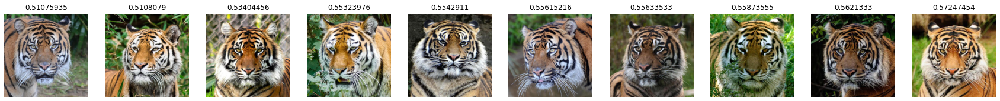

ORB CBIR


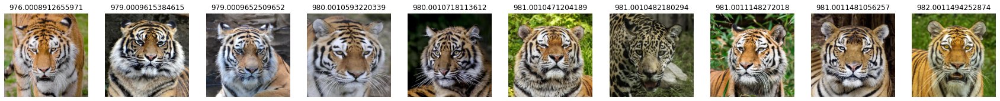

Combined CBIR


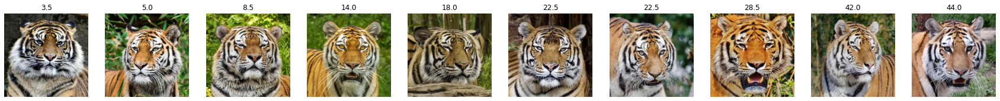

In [30]:
query("/content/drive/MyDrive/IREI/dataset/test/tigre.jpg")

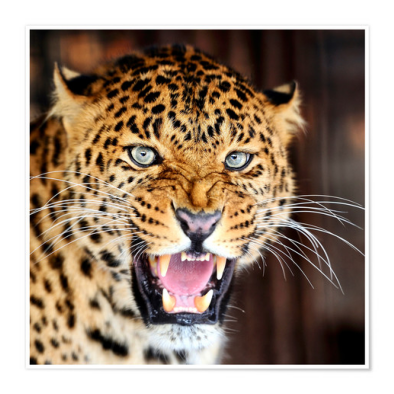

CNN CBIR


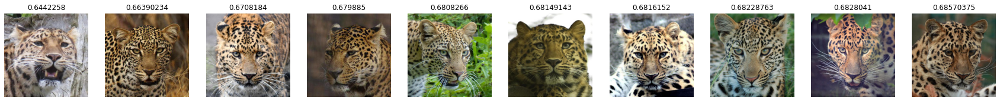

ORB CBIR


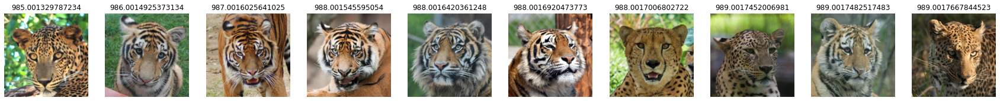

Combined CBIR


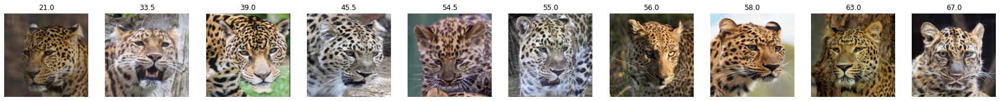

In [31]:
query("/content/drive/MyDrive/IREI/dataset/test/leopardo.jpg")

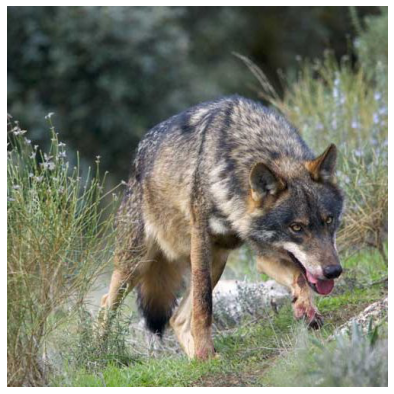

CNN CBIR


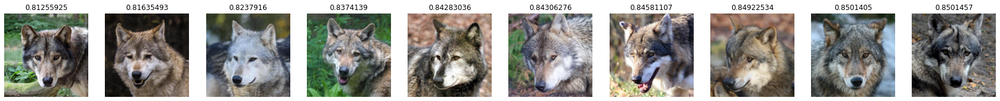

ORB CBIR


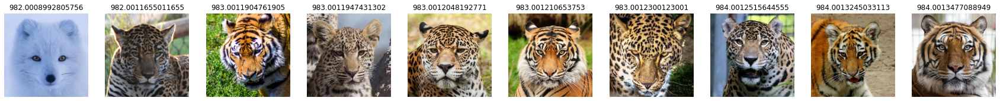

Combined CBIR


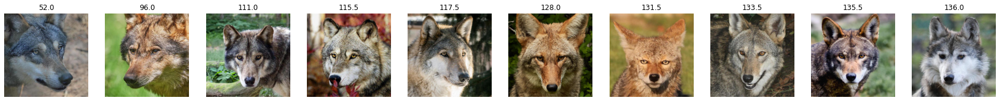

In [32]:
query("/content/drive/MyDrive/IREI/dataset/test/lobo.jpg")

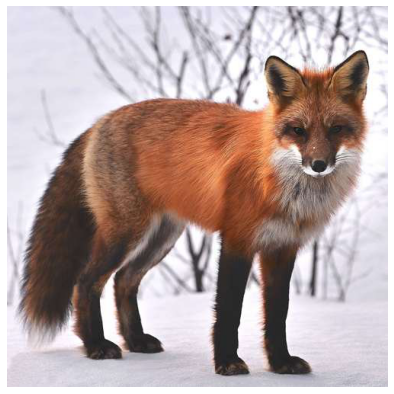

CNN CBIR


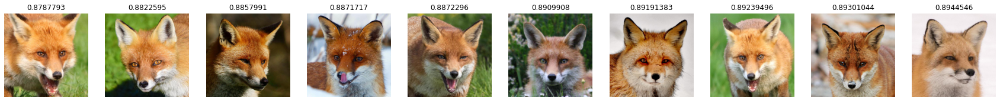

ORB CBIR


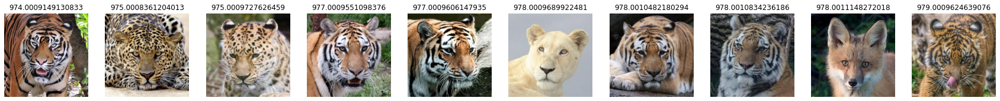

Combined CBIR


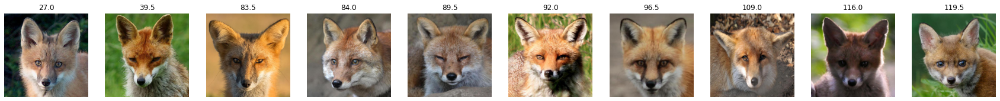

In [33]:
query("/content/drive/MyDrive/IREI/dataset/test/zorro.jpg")

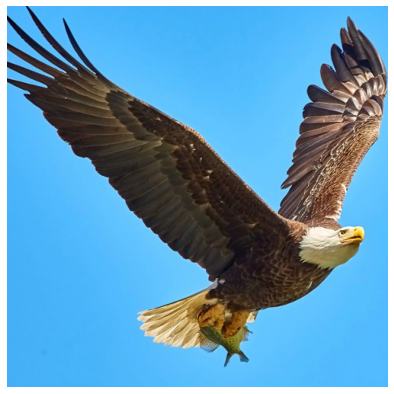

CNN CBIR


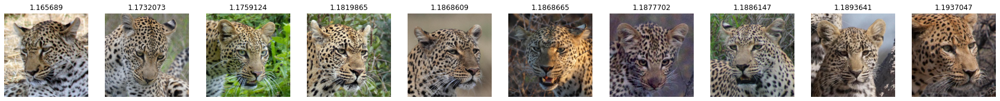

ORB CBIR


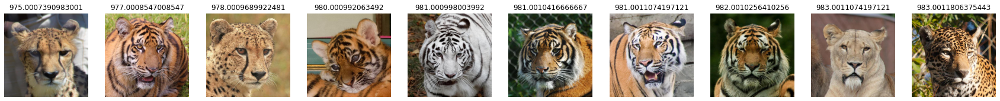

Combined CBIR


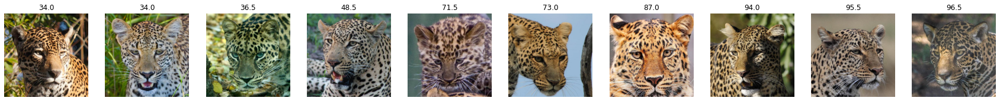

In [34]:
query("/content/drive/MyDrive/IREI/dataset/test/eagle.jpg")

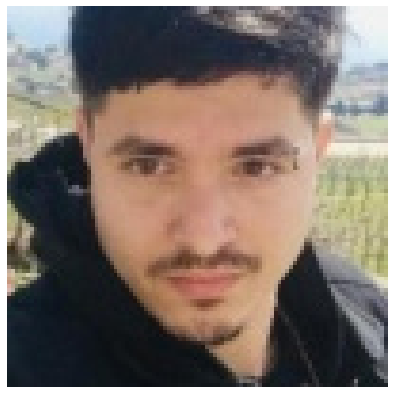

CNN CBIR


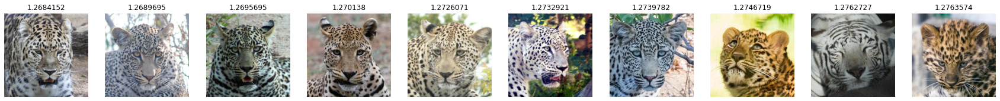

ORB CBIR


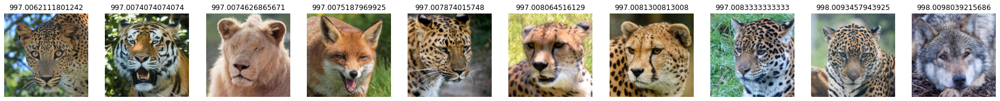

Combined CBIR


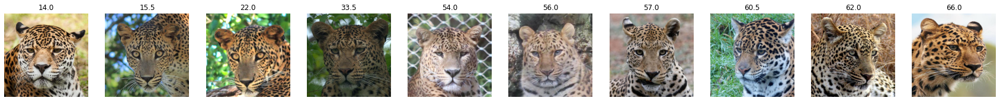

In [35]:
query("/content/drive/MyDrive/IREI/dataset/test/humano.jpg")

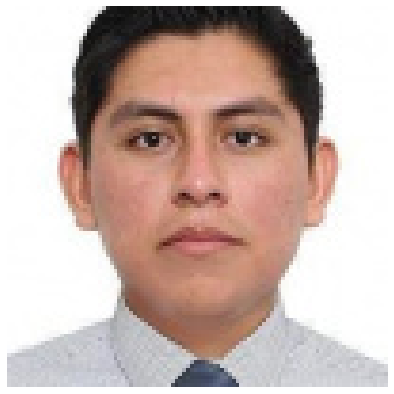

CNN CBIR


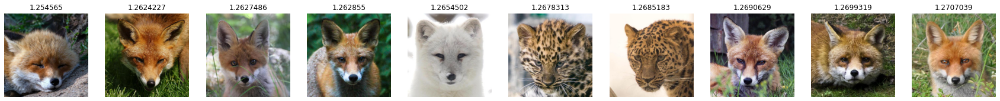

ORB CBIR


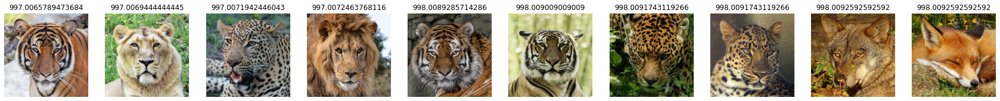

Combined CBIR


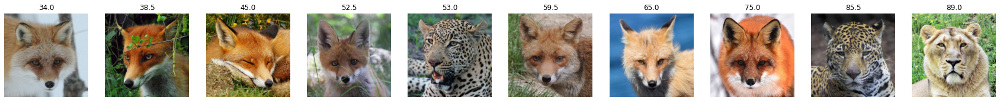

In [36]:
query("/content/drive/MyDrive/IREI/dataset/test/humano2.jpg")

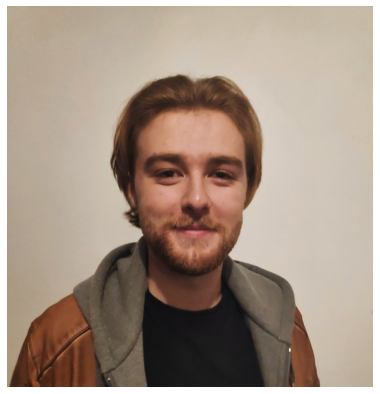

CNN CBIR


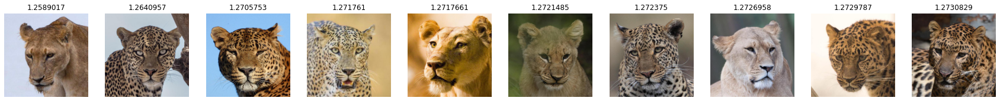

ORB CBIR


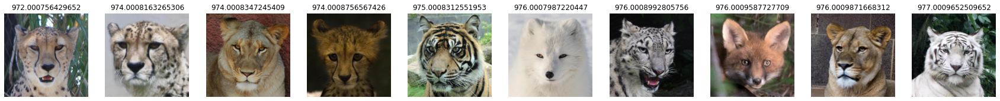

Combined CBIR


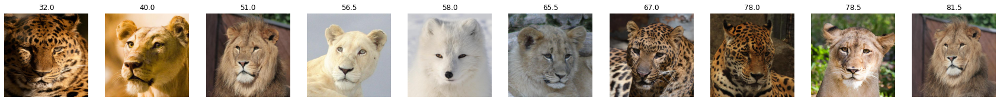

In [37]:
query("/content/drive/MyDrive/IREI/dataset/test/humano3.jpg")

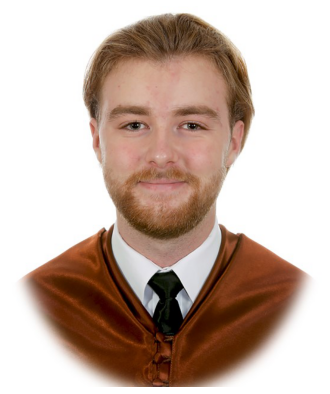

CNN CBIR


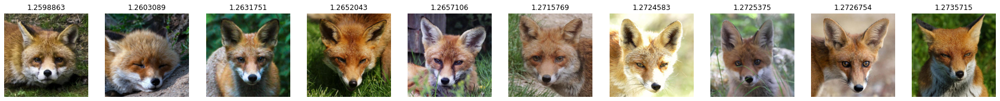

ORB CBIR


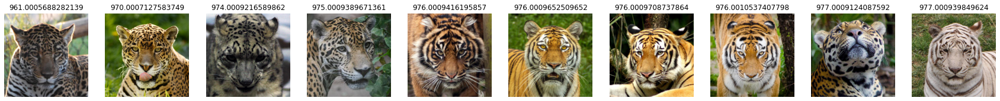

Combined CBIR


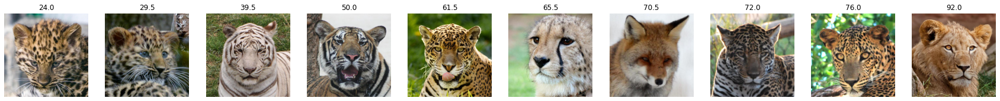

In [38]:
query("/content/drive/MyDrive/IREI/dataset/test/humano4.jpg")